In [1]:
from templates import *

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: saranga7. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /users/biocomp/mahanta/.netrc


In [2]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import random

In [3]:
def set_seed(seed):
    #Sets the seed for Reprocudibility
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
        torch.backends.cudnn.deterministic = True
        
set_seed(7)

In [40]:
class Classifier(nn.Module):

    def __init__(self, classifier_checkpoint_path, num_classes = 2):
        super().__init__()
        self.mobile_net = torch.hub.load('pytorch/vision:v0.10.0', 'mobilenet_v2')
        self.mobile_net.classifier[1] = nn.Linear(1280, num_classes)
        self.mobile_net.load_state_dict(torch.load(classifier_checkpoint_path))# map_location = device))

        for param in self.mobile_net.parameters():
                param.requires_grad = False

        
    def forward(self, x):       
        logits = self.mobile_net(x)
        probabilities = F.softmax(logits, dim = 1)

        return probabilities

In [45]:
classifier = Classifier('checkpoints/classifier/FFHQ_Gender.pth').to(device)

Using cache found in /users/biocomp/mahanta/.cache/torch/hub/pytorch_vision_v0.10.0


In [4]:
n_components = 10
model_type = 'baseline'

In [8]:
device = 'cuda:0'
conf = ffhq128_autoenc_130M()
conf.include_classifier = False
# conf.name = 'ffhq128_autoenc_w_classifier_weightedLoss_step_BN'
# conf.name = 'ffhq128_w_newclassifier2'
print(conf.name)
model = LitModel(conf)
state = torch.load(f'checkpoints/{conf.name}/last.ckpt', map_location='cpu')
model.load_state_dict(state['state_dict'], strict=False)

model.model.eval()
model.ema_model.eval()




Global seed set to 0


ffhq128_autoenc_130M


Using cache found in /users/biocomp/mahanta/.cache/torch/hub/pytorch_vision_v0.10.0


Model params: 124.96 M


BeatGANsAutoencModel(
  (time_embed): TimeStyleSeperateEmbed(
    (time_embed): Sequential(
      (0): Linear(in_features=128, out_features=512, bias=True)
      (1): SiLU()
      (2): Linear(in_features=512, out_features=512, bias=True)
    )
    (style): Identity()
  )
  (input_blocks): ModuleList(
    (0): TimestepEmbedSequential(
      (0): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1-2): 2 x TimestepEmbedSequential(
      (0): ResBlock(
        (in_layers): Sequential(
          (0): GroupNorm32(32, 128, eps=1e-05, affine=True)
          (1): SiLU()
          (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        )
        (h_upd): Identity()
        (x_upd): Identity()
        (emb_layers): Sequential(
          (0): SiLU()
          (1): Linear(in_features=512, out_features=256, bias=True)
        )
        (cond_emb_layers): Sequential(
          (0): SiLU()
          (1): Linear(in_features=512, out_features=128, bias

In [9]:
model.ema_model.to(device)
model.model.to(device)

BeatGANsAutoencModel(
  (time_embed): TimeStyleSeperateEmbed(
    (time_embed): Sequential(
      (0): Linear(in_features=128, out_features=512, bias=True)
      (1): SiLU()
      (2): Linear(in_features=512, out_features=512, bias=True)
    )
    (style): Identity()
  )
  (input_blocks): ModuleList(
    (0): TimestepEmbedSequential(
      (0): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1-2): 2 x TimestepEmbedSequential(
      (0): ResBlock(
        (in_layers): Sequential(
          (0): GroupNorm32(32, 128, eps=1e-05, affine=True)
          (1): SiLU()
          (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        )
        (h_upd): Identity()
        (x_upd): Identity()
        (emb_layers): Sequential(
          (0): SiLU()
          (1): Linear(in_features=512, out_features=256, bias=True)
        )
        (cond_emb_layers): Sequential(
          (0): SiLU()
          (1): Linear(in_features=512, out_features=128, bias

In [10]:
print(model.model.classifier_component)

Classifier_Component(
  (mobile_net): MobileNetV2(
    (features): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU6(inplace=True)
      )
      (1): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU6(inplace=True)
          )
          (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
      )
      (2): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 96, ke

In [11]:
data = ImageDataset('imgs_align', image_size=conf.img_size, exts=['jpg', 'JPG', 'png'], do_augment=False)
# batch = data[1]['img'][None]

In [12]:
x = glob.glob('imgs_align/*')
len(x)

994

In [13]:
# image_dataset = [data[idx]['img'] for idx in tqdm(range(len(data)))]

image_dataset = [data[idx]['img'] for idx in tqdm(range(len(data)))]


  0%|          | 0/994 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-3.8912823..5.078203].


43

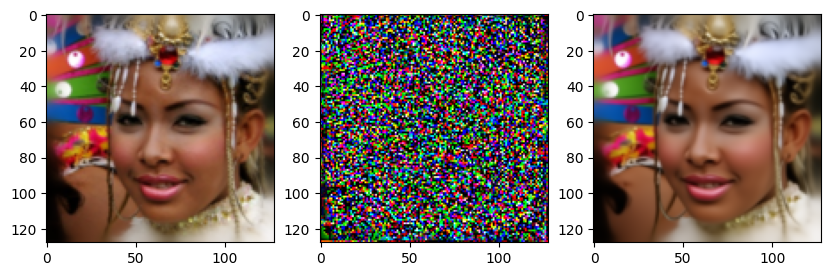

In [14]:
trial_img = data[0]['img'][None].to(device)
cond = model.encode(trial_img)
xT = model.encode_stochastic(trial_img, cond, T = 100)
pred = model.render(xT, cond, T = 50)

fig, ax = plt.subplots(1, 3, figsize=(10, 5))
ori = (trial_img + 1) / 2
ax[0].imshow(ori[0].permute(1, 2, 0).cpu())
ax[1].imshow(xT[0].permute(1, 2, 0).cpu())
ax[2].imshow(pred[0].permute(1, 2, 0).cpu())


del cond, xT, pred, trial_img, ori
import gc
gc.collect()

In [15]:
len(image_dataset)

994

In [16]:
image_dataset = torch.stack(image_dataset)
print(f"Shape of the stacked sampled images tensor: {image_dataset.shape}")
# Output should be [100, 3, 128, 128] confirming the stack of 100 images with the dimensions [3, 128, 128]
image_dataset = image_dataset.to(device)
# Z = sampled_images_tensor

Shape of the stacked sampled images tensor: torch.Size([994, 3, 128, 128])


In [17]:
def batch_encode(model, data, batch_size = 128, mode='non_ema'):
    """
    Encode data in batches to avoid out-of-memory issues.
    """
    all_encoded = []
    with torch.no_grad():
        for i in tqdm(range(0, len(data), batch_size)):
            batch = data[i:i + batch_size]
            Z_sem = model.encode(batch, mode=mode)
            # Z_sem = model.model.classifier_component(x=batch, cond=W)
            all_encoded.append(Z_sem)
    return torch.cat(all_encoded, dim=0)

In [46]:
def apply_and_visualize_pca(image_data, direction_idx, magnitudes, random_indices, model_type = model_type, n_components = 10, T = 100, mode = 'non_ema'):
    
    # Encode and apply PCA
    if len(image_data) > 128:
        Z_sem = batch_encode(model, image_data, mode = mode)
    else:
        Z_sem = model.encode(image_data, mode = mode)
        # Z_sem = model.model.classifier_component(x = image_data, cond = W)

    
    pca = PCA(n_components=n_components)
    pca.fit(Z_sem.detach().cpu().numpy())
    V = pca.components_
    V = torch.tensor(V).to(device)
    
    # Sample images and their latent representations
    sampled_images = image_data[random_indices]
    Z_sem_sampled = Z_sem[random_indices]

    fig, ax = plt.subplots(len(random_indices), len(magnitudes) * 2 + 1, figsize=(15, 3 * len(random_indices)))

    for j in range(len(random_indices)):
        ori = (sampled_images + 1) / 2
        # Original image in the center
        ax[j][len(magnitudes)].imshow(ori[j].permute(1, 2, 0).cpu())
        classifier_output = classifier(sampled_images[j:j+1])
        formatted_output = [f"{x:.2f}" for x in classifier_output.cpu().detach().numpy().flatten()]
        ax[j][len(magnitudes)].set_title(f"Original\n{formatted_output}")
        ax[j][len(magnitudes)].axis('off')

    xT = model.encode_stochastic(sampled_images, Z_sem_sampled, T=T, mode=mode)
    
    for i, magnitude in tqdm(enumerate(magnitudes)):
        Z_sem_positive_shifted = Z_sem_sampled + V[direction_idx, :] * magnitude
        Z_sem_negative_shifted = Z_sem_sampled - V[direction_idx, :] * magnitude
        
        pred_positive_shifted = model.render(xT, Z_sem_positive_shifted, T=T, mode=mode)
        pred_negative_shifted = model.render(xT, Z_sem_negative_shifted, T=T, mode=mode)
        
        for j in range(len(random_indices)):
            # Negative shifts on the left
            neg_classifier_output = classifier(pred_negative_shifted[j:j+1])
            formatted_neg_output = [f"{x:.2f}" for x in neg_classifier_output.cpu().detach().numpy().flatten()]
            ax[j][len(magnitudes) - i - 1].imshow(pred_negative_shifted[j].permute(1, 2, 0).cpu())
            ax[j][len(magnitudes) - i - 1].set_title(f"-{magnitude}\n{formatted_neg_output}")
            ax[j][len(magnitudes) - i - 1].axis('off')
            
            # Positive shifts on the right
            pos_classifier_output = classifier(pred_positive_shifted[j:j+1])
            formatted_pos_output = [f"{x:.2f}" for x in pos_classifier_output.cpu().detach().numpy().flatten()]
            ax[j][len(magnitudes) + i + 1].imshow(pred_positive_shifted[j].permute(1, 2, 0).cpu())
            ax[j][len(magnitudes) + i + 1].set_title(f"+{magnitude}\n{formatted_pos_output}")
            ax[j][len(magnitudes) + i + 1].axis('off')
    
    # Set the overall plot title
    fig.suptitle(f"Along Principal Component {direction_idx}")
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    save_path = os.path.join('pca_analysis_results', model_type)
    plt.savefig(f'{save_path}/PC_{direction_idx}.png')
    plt.show()

In [47]:
random_indices = random.sample(range(len(image_dataset)), 5)
random_indices

[505, 847, 888, 341, 249]

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

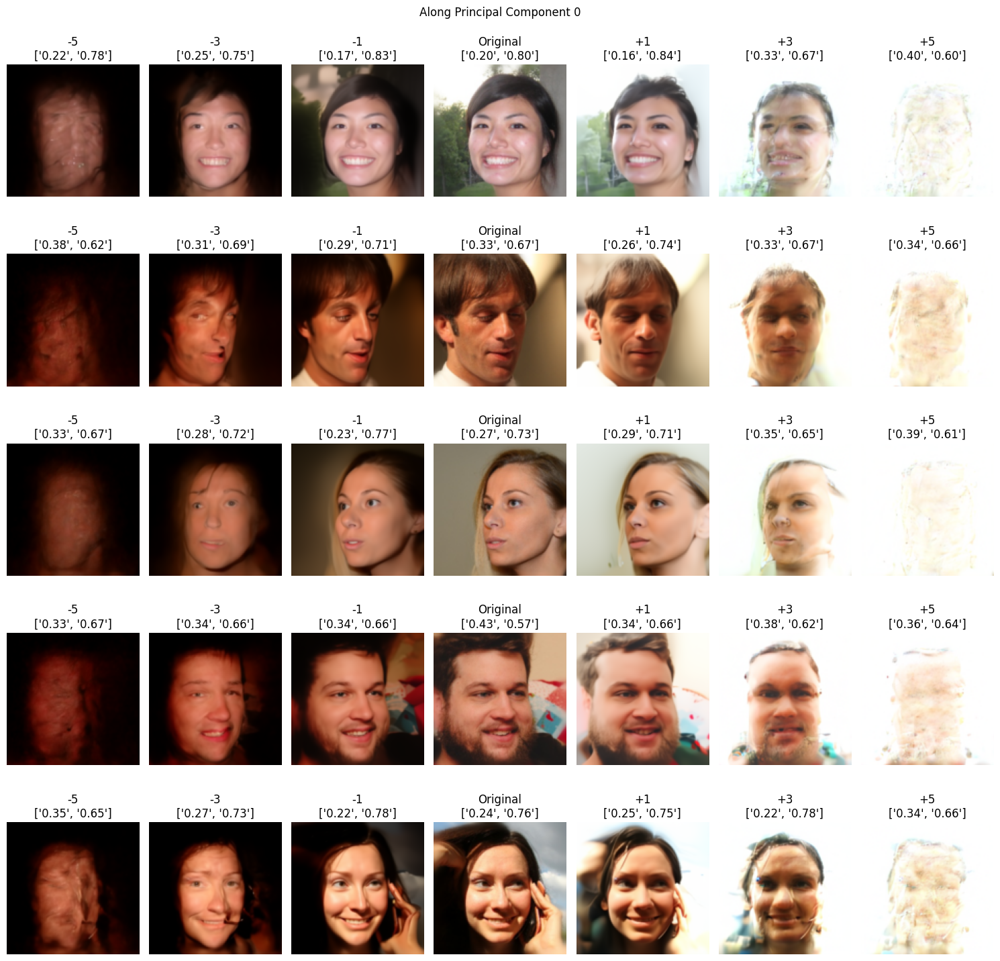

In [48]:
apply_and_visualize_pca(image_dataset, direction_idx = 0, magnitudes = [1, 3, 5], random_indices = random_indices)

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

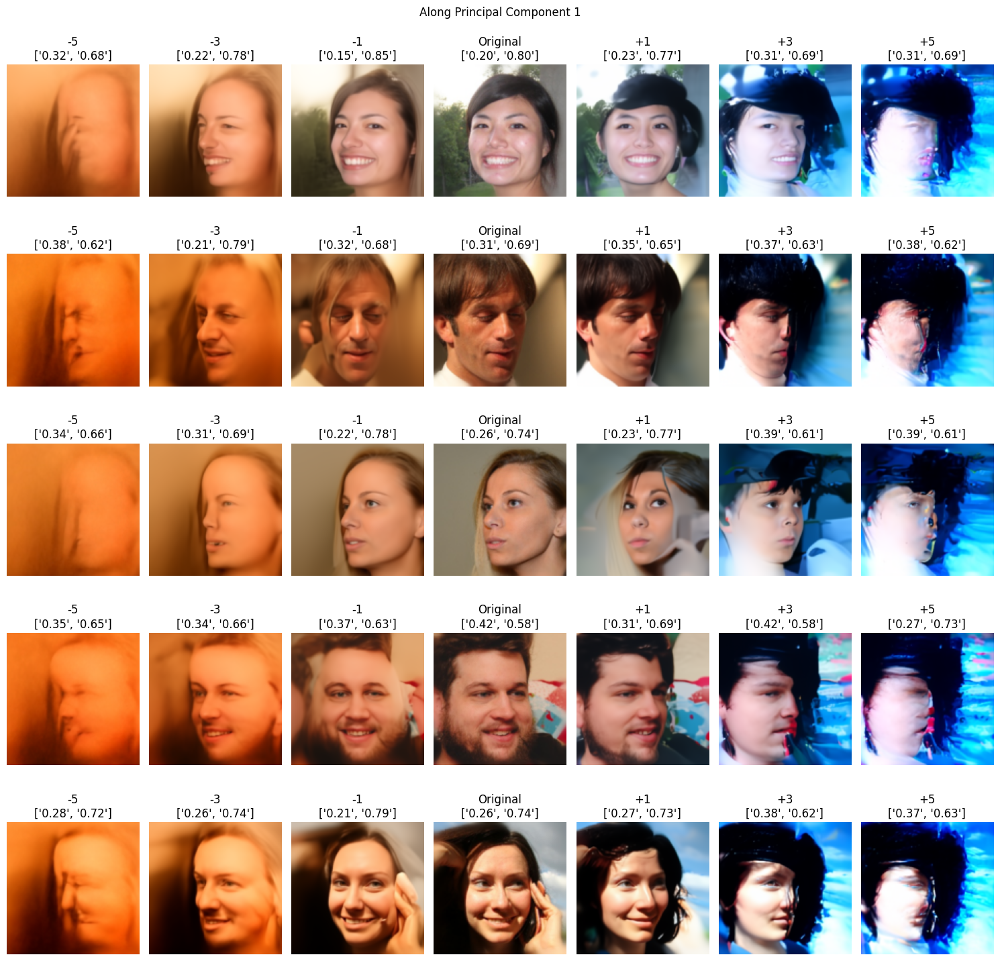

In [49]:
apply_and_visualize_pca(image_dataset, direction_idx = 1, magnitudes = [1, 3, 5], random_indices = random_indices)

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

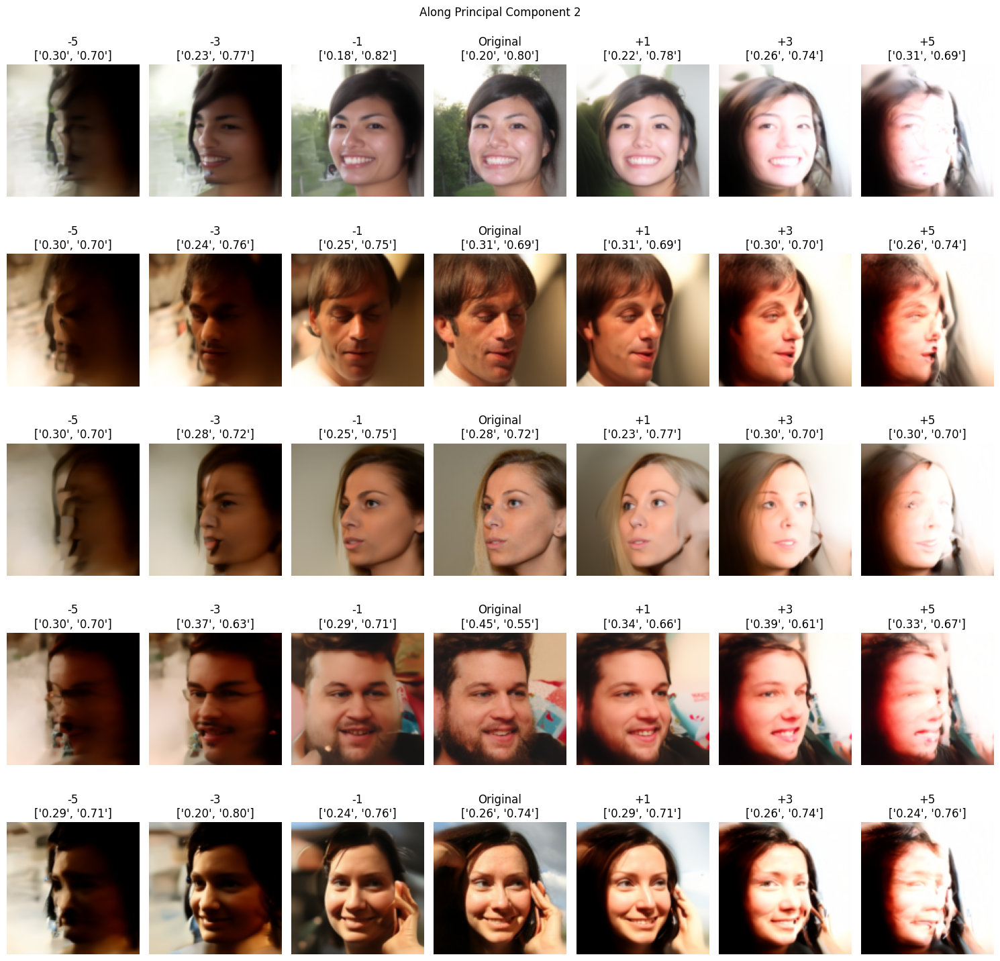

In [50]:
apply_and_visualize_pca(image_dataset, direction_idx = 2, magnitudes = [1, 3, 5], random_indices = random_indices)

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

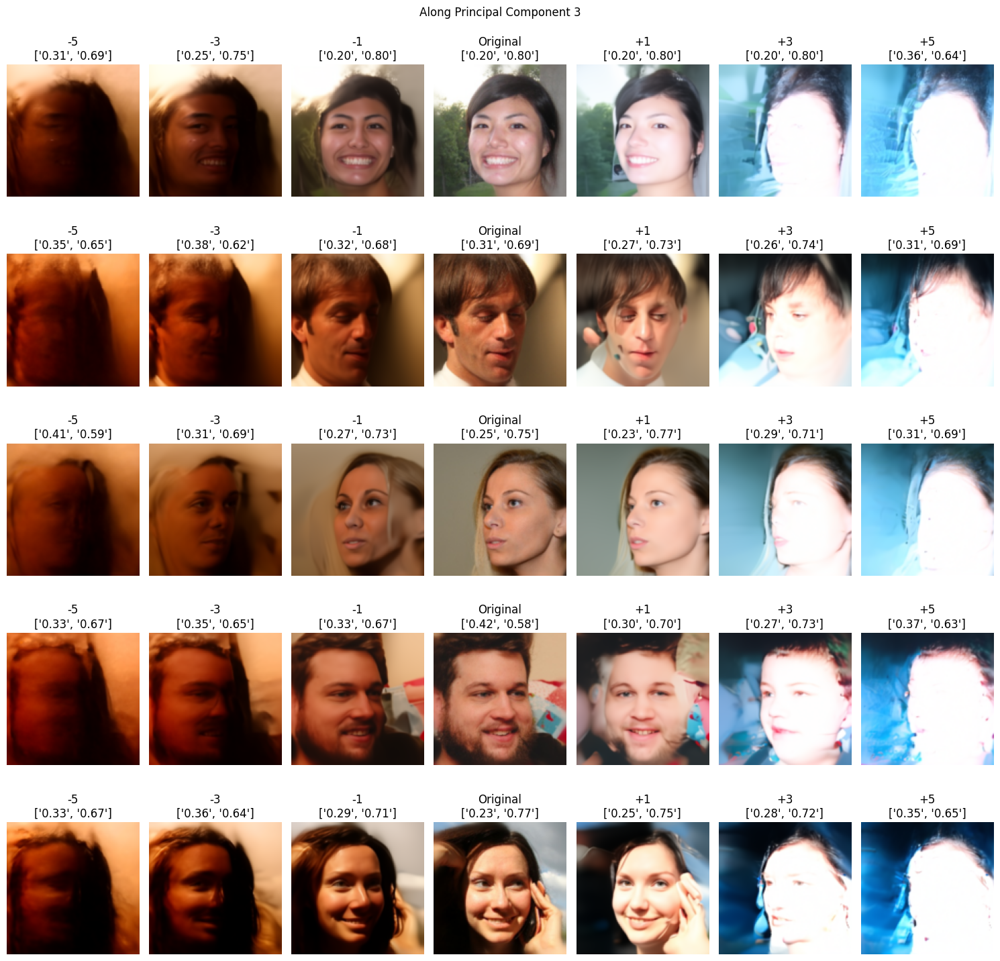

In [51]:
apply_and_visualize_pca(image_dataset, direction_idx = 3, magnitudes = [1, 3, 5], random_indices = random_indices)

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

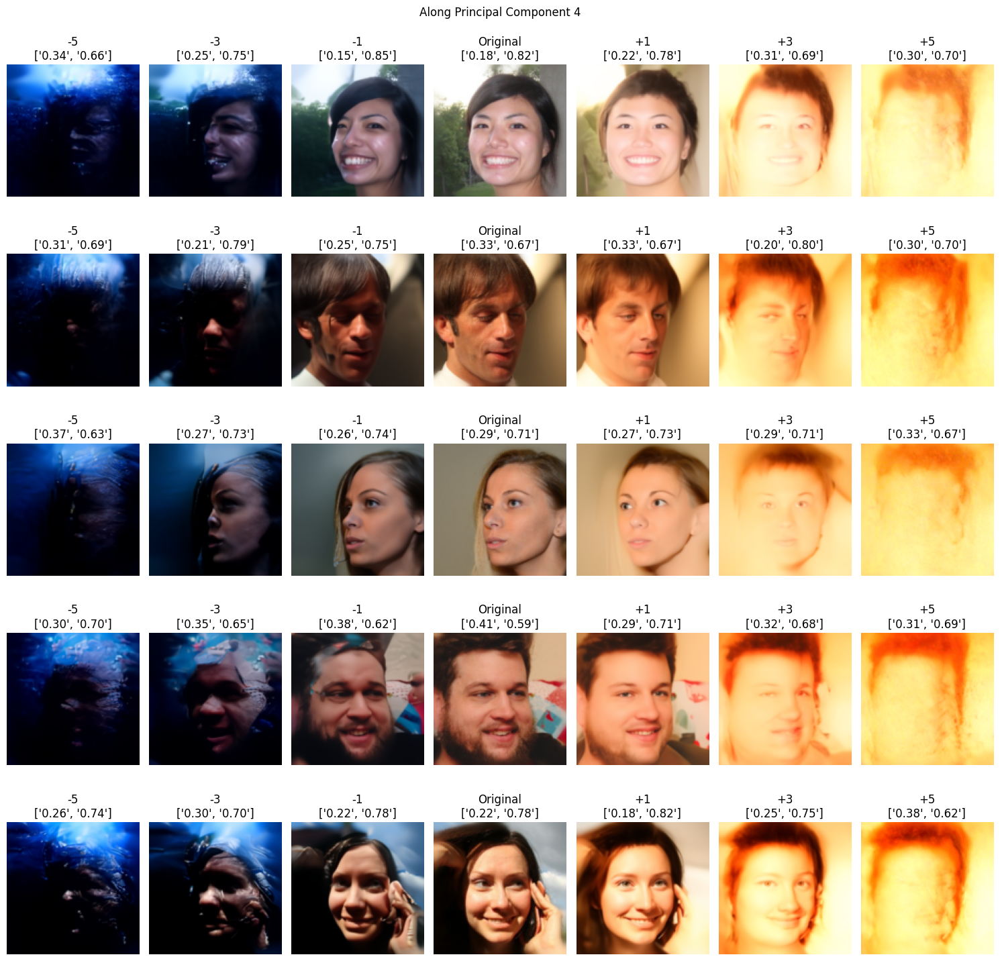

In [52]:
apply_and_visualize_pca(image_dataset, direction_idx = 4, magnitudes = [1, 3, 5], random_indices = random_indices)

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

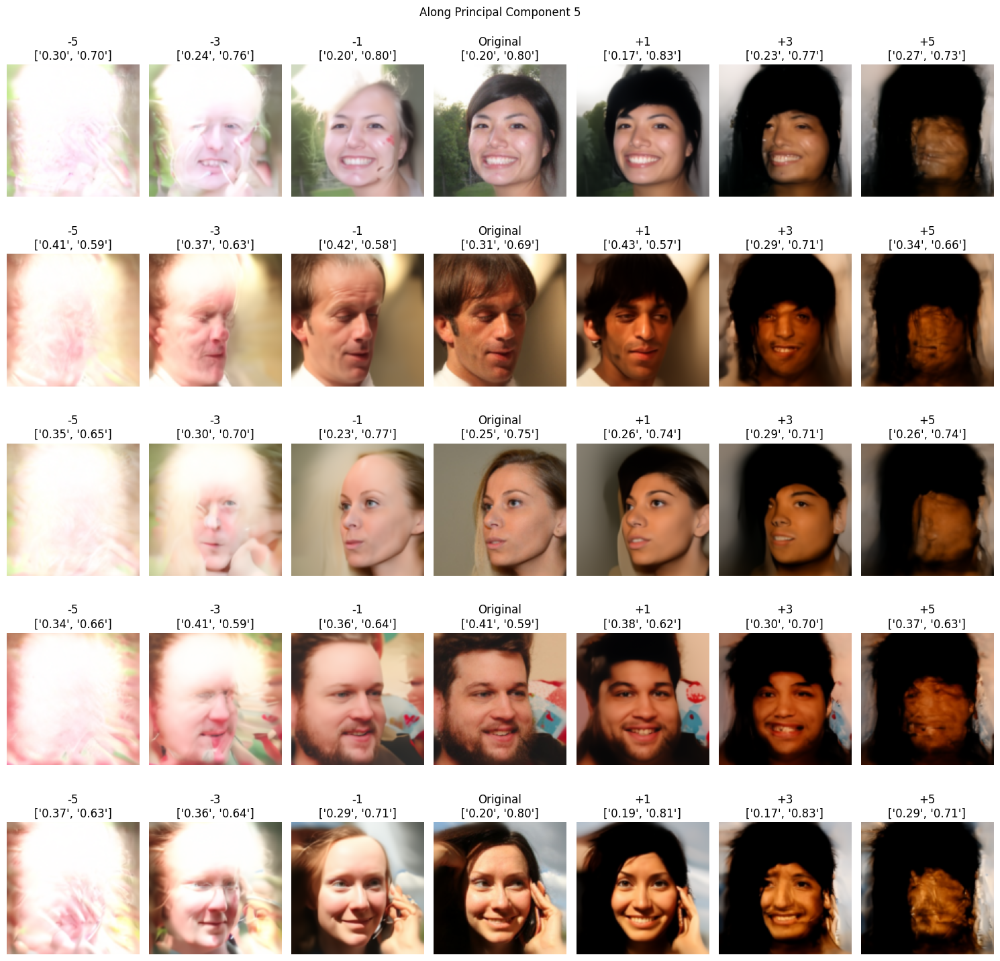

In [53]:
apply_and_visualize_pca(image_dataset, direction_idx = 5, magnitudes = [1, 3, 5], random_indices = random_indices)

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

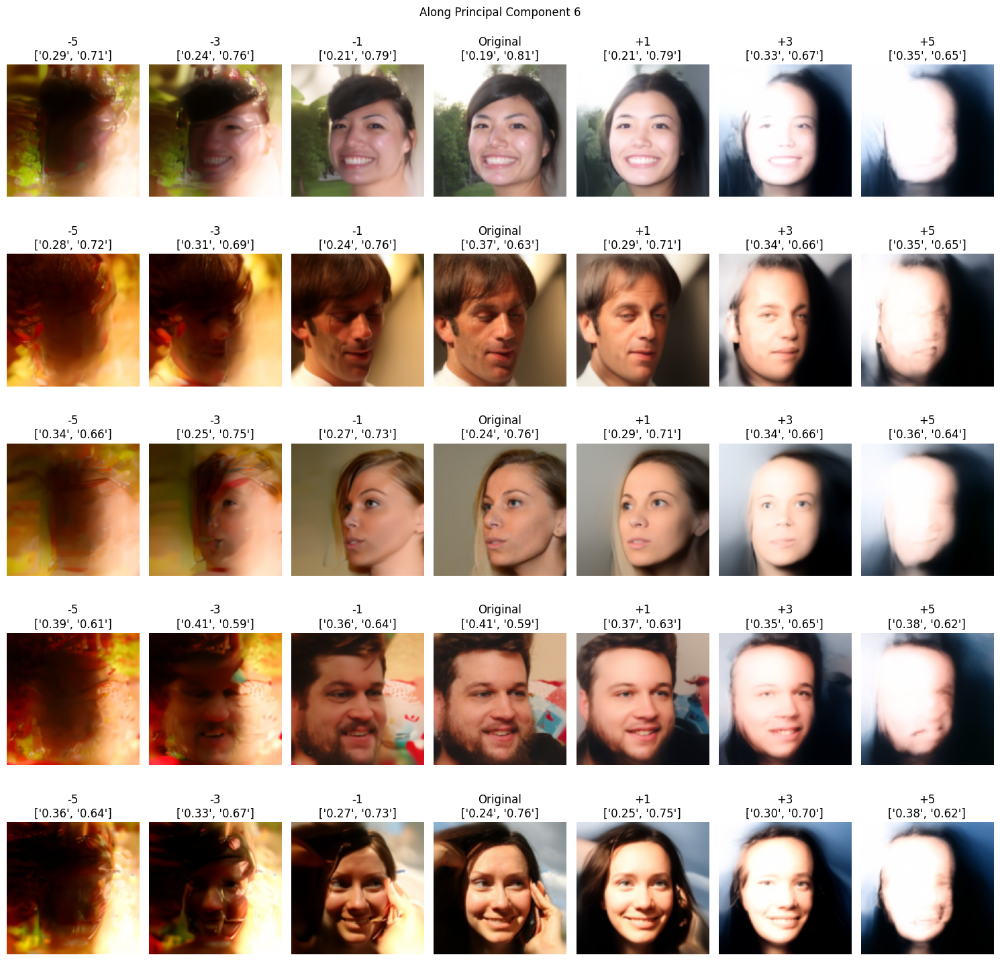

In [54]:
apply_and_visualize_pca(image_dataset, direction_idx = 6, magnitudes = [1, 3, 5], random_indices = random_indices)

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

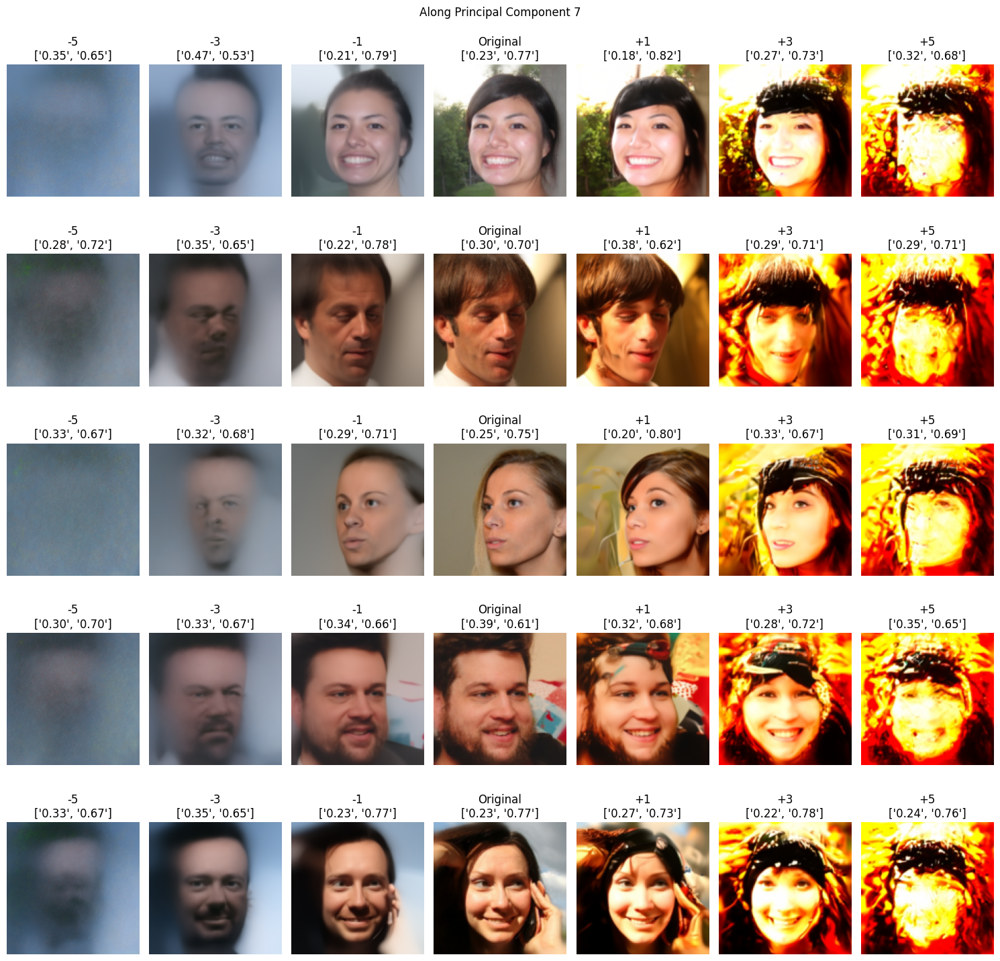

In [55]:
apply_and_visualize_pca(image_dataset, direction_idx = 7, magnitudes = [1, 3, 5], random_indices = random_indices)

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

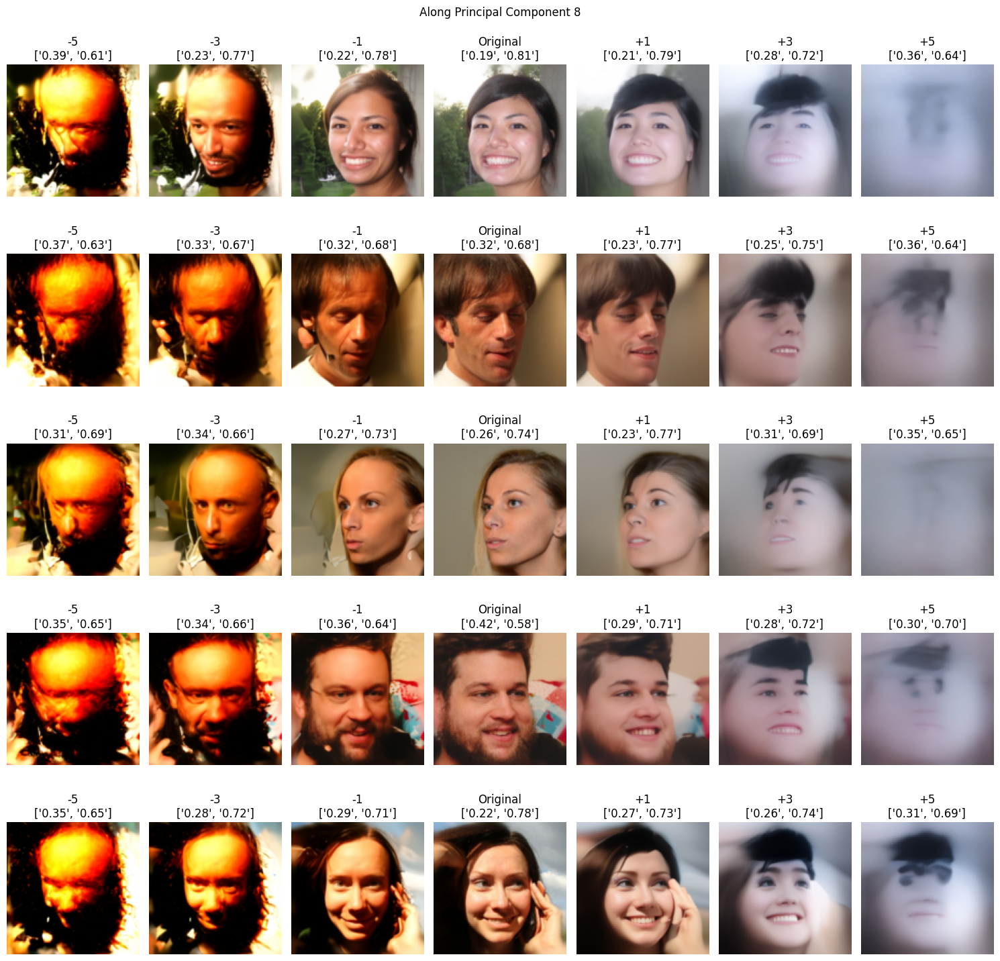

In [56]:
apply_and_visualize_pca(image_dataset, direction_idx = 8, magnitudes = [1, 3, 5], random_indices = random_indices)

  0%|          | 0/8 [00:00<?, ?it/s]

0it [00:00, ?it/s]

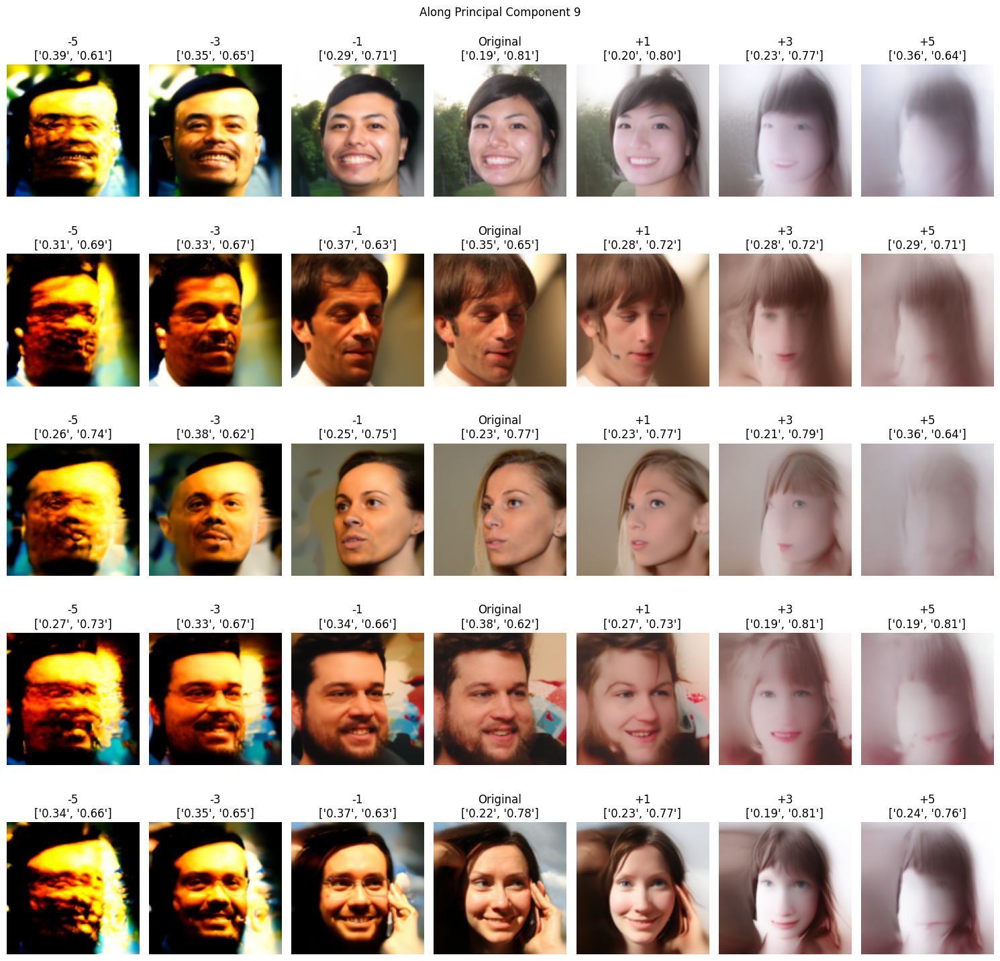

In [57]:
apply_and_visualize_pca(image_dataset, direction_idx = 9, magnitudes = [1, 3, 5], random_indices = random_indices)